# NBA Passing Network Analysis

Interactive visualization and analysis of NBA passing networks across multiple seasons (2014-2024).

In [6]:
import networkx as nx
import pandas as pd
from pyvis.network import Network
import math
from IPython.display import HTML, display
import matplotlib.pyplot as plt
import numpy as np

## 1. Load Network Data

In [7]:
# Load both networks
print("Loading networks...")
G_assist = nx.read_gexf('output/nba_assist_network.gexf')
G_pass = nx.read_gexf('output/nba_pass_network.gexf')

print(f"Assist Network: {G_assist.number_of_nodes()} nodes, {G_assist.number_of_edges()} edges")
print(f"Pass Network: {G_pass.number_of_nodes()} nodes, {G_pass.number_of_edges()} edges")

Loading networks...
Assist Network: 5111 nodes, 53776 edges
Pass Network: 5111 nodes, 63493 edges


## 2. Network Statistics

In [8]:
def analyze_network(G, name="Network"):
    print(f"\n=== {name} ===")
    print(f"Nodes: {G.number_of_nodes()}")
    print(f"Edges: {G.number_of_edges()}")
    print(f"Density: {nx.density(G):.6f}")
    
    # Degree statistics
    out_degrees = dict(G.out_degree())
    in_degrees = dict(G.in_degree())
    
    print(f"\nOut-degree stats:")
    print(f"  Mean: {np.mean(list(out_degrees.values())):.2f}")
    print(f"  Max: {max(out_degrees.values())}")
    print(f"  Min: {min(out_degrees.values())}")
    
    # Top 10 nodes by out-degree
    top_out = sorted(out_degrees.items(), key=lambda x: x[1], reverse=True)[:10]
    print(f"\nTop 10 by out-degree (most passes/assists):")
    for i, (node, deg) in enumerate(top_out, 1):
        print(f"  {i}. {node}: {deg}")

analyze_network(G_assist, "Assist Network")
analyze_network(G_pass, "Pass Network")


=== Assist Network ===
Nodes: 5111
Edges: 53776
Density: 0.002059

Out-degree stats:
  Mean: 10.52
  Max: 22
  Min: 0

Top 10 by out-degree (most passes/assists):
  1. Marcus Sasser, DET, 2023-24: 22
  2. Jaden Ivey, DET, 2023-24: 21
  3. Mike Conley, MEM, 2018-19: 20
  4. Jae'Sean Tate, HOU, 2020-21: 20
  5. Anfernee Simons, POR, 2021-22: 19
  6. Ben McLemore, POR, 2021-22: 19
  7. Cade Cunningham, DET, 2023-24: 19
  8. Miles Bridges, CHA, 2023-24: 19
  9. Shane Larkin, NYK, 2014-15: 18
  10. Ben Simmons, PHI, 2018-19: 18

=== Pass Network ===
Nodes: 5111
Edges: 63493
Density: 0.002431

Out-degree stats:
  Mean: 12.42
  Max: 23
  Min: 0

Top 10 by out-degree (most passes/assists):
  1. Marcus Sasser, DET, 2023-24: 23
  2. Jaden Ivey, DET, 2023-24: 23
  3. Cade Cunningham, DET, 2023-24: 22
  4. Ausar Thompson, DET, 2023-24: 22
  5. Jae'Sean Tate, HOU, 2020-21: 21
  6. Danuel House Jr., HOU, 2020-21: 21
  7. Christian Wood, HOU, 2020-21: 21
  8. CJ Elleby, POR, 2021-22: 21
  9. Anferne

## 3. Interactive Visualization Function

In [9]:
def visualize_network(G, output_file='network.html', height='800px'):
    """
    Create an interactive visualization with improved node sizing and edge labels.
    """
    # Create PyVis network
    net = Network(height=height, width='100%', bgcolor='#222222', 
                  font_color='white', directed=True, notebook=True)
    
    # Calculate layout
    print("Calculating layout...")
    pos = nx.spring_layout(G, k=0.5, iterations=50, seed=42)
    
    # Calculate out-degrees for sizing
    out_degrees = dict(G.out_degree())
    max_out_degree = max(out_degrees.values()) if out_degrees else 1
    
    # Node sizing parameters
    min_size = 5
    max_size = 100
    scale = 1000
    
    # Apply node properties
    print("Setting node properties...")
    for node, coords in pos.items():
        G.nodes[node]['x'] = coords[0] * scale
        G.nodes[node]['y'] = coords[1] * scale
        
        # Logarithmic size scaling
        out_deg = out_degrees.get(node, 0)
        if out_deg > 0:
            log_deg = math.log(1 + out_deg)
            max_log = math.log(1 + max_out_degree)
            node_size = min_size + (log_deg / max_log) * (max_size - min_size)
        else:
            node_size = min_size
        
        G.nodes[node]['size'] = node_size
        G.nodes[node]['label'] = node.split(',')[0]  # Player name only
        G.nodes[node]['title'] = f"{node}\nOut-degree: {out_deg}"
    
    # Add edge labels
    print("Setting edge properties...")
    for source, target, data in G.edges(data=True):
        weight = data.get('weight', 1)
        G[source][target]['label'] = str(int(weight))
        G[source][target]['title'] = f"Weight: {weight}"
    
    net.from_nx(G)
    net.toggle_physics(False)
    
    # Set visualization options
    net.set_options('''
    {
      "nodes": {
        "font": {"size": 14, "strokeWidth": 2, "strokeColor": "#222222"},
        "scaling": {"label": {"enabled": true, "min": 10, "max": 30}}
      },
      "edges": {
        "arrows": {"to": {"enabled": true, "scaleFactor": 0.5}},
        "color": {"inherit": "from", "opacity": 0.6},
        "smooth": {"enabled": true, "type": "curvedCW", "roundness": 0.1},
        "width": 1,
        "font": {"size": 10, "align": "middle", "background": "rgba(0,0,0,0.7)"}
      },
      "interaction": {
        "hover": true,
        "tooltipDelay": 100,
        "zoomView": true,
        "dragView": true,
        "hideEdgesOnDrag": true,
        "hideEdgesOnZoom": true
      }
    }
    ''')
    
    print(f"Saving to {output_file}...")
    net.save_graph(output_file)
    return net

## 4. Filter Network by Season or Player

In [10]:
def filter_by_season(G, season):
    """
    Filter network to only include nodes from a specific season.
    """
    nodes_in_season = [n for n in G.nodes() if season in n]
    return G.subgraph(nodes_in_season).copy()

def filter_by_player(G, player_name):
    """
    Filter network to show a specific player and their connections across all seasons.
    """
    # Find all nodes for this player (across all seasons)
    player_nodes = [n for n in G.nodes() if n.startswith(player_name + ',')]
    
    # Get all neighbors
    all_nodes = set(player_nodes)
    for node in player_nodes:
        all_nodes.update(G.predecessors(node))
        all_nodes.update(G.successors(node))
    
    return G.subgraph(all_nodes).copy()

# Example: Get available seasons
seasons = set()
for node in G_pass.nodes():
    parts = node.split(', ')
    if len(parts) >= 3:
        seasons.add(parts[2])

print("Available seasons:", sorted(seasons))

Available seasons: ['2014-15', '2015-16', '2016-17', '2017-18', '2018-19', '2019-20', '2020-21', '2021-22', '2022-23', '2023-24', '2024-25']


## 5. Visualize Full Networks

**Warning**: This may take a few minutes for large networks!

In [12]:
# Visualize Assist Network
net_assist = visualize_network(G_assist, 'assist_network.html')
display(HTML('assist_network.html'))

Calculating layout...
Setting node properties...
Setting edge properties...
Saving to assist_network.html...


In [13]:
# Visualize Pass Network
net_pass = visualize_network(G_pass, 'pass_network.html')
display(HTML('pass_network.html'))

Calculating layout...
Setting node properties...
Setting edge properties...
Saving to pass_network.html...


## 6. Filter and Visualize by Season

Pick a season to explore:

In [14]:
# Change this to any season you want
selected_season = '2023-24'

G_season = filter_by_season(G_pass, selected_season)
print(f"Season {selected_season}: {G_season.number_of_nodes()} nodes, {G_season.number_of_edges()} edges")

net_season = visualize_network(G_season, f'season_{selected_season}.html', height='700px')
display(HTML(f'season_{selected_season}.html'))

Season 2023-24: 465 nodes, 5987 edges
Calculating layout...
Setting node properties...
Setting edge properties...
Saving to season_2023-24.html...


## 7. Filter and Visualize by Player

Explore a specific player's network across all seasons:

In [ ]:
# Change this to any player name
player_name = 'LeBron James'

G_player = filter_by_player(G_pass, player_name)
print(f"Player {player_name}: {G_player.number_of_nodes()} nodes, {G_player.number_of_edges()} edges")

net_player = visualize_network(G_player, f'player_{player_name.replace(" ", "_")}.html', height='700px')
# display(HTML(f'player_{player_name.replace(" ", "_")}.html'))

Player LeBron James: 174 nodes, 2212 edges
Calculating layout...
Setting node properties...
Setting edge properties...
Saving to player_LeBron_James.html...


## 8. Degree Distribution Analysis

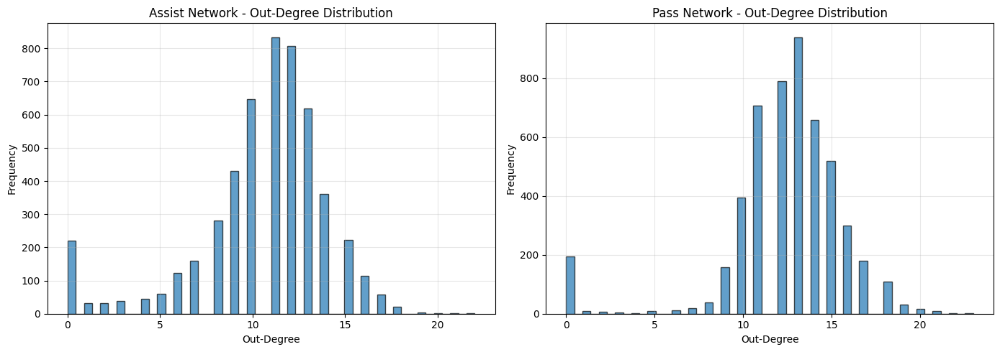

In [16]:
# Plot degree distributions
fig, axes = plt.subplots(1, 2, figsize=(14, 5))

for idx, (G, name) in enumerate([(G_assist, 'Assist'), (G_pass, 'Pass')]):
    out_degrees = [d for n, d in G.out_degree()]
    
    axes[idx].hist(out_degrees, bins=50, edgecolor='black', alpha=0.7)
    axes[idx].set_xlabel('Out-Degree')
    axes[idx].set_ylabel('Frequency')
    axes[idx].set_title(f'{name} Network - Out-Degree Distribution')
    axes[idx].grid(True, alpha=0.3)

plt.tight_layout()
plt.show()

## 9. Improved Team-Based Visualization

Better visualization with:
- **Team colors** - Each NBA team gets a distinct color
- **Node size by weighted degree** - Players with more assists (given + received) are larger
- **Edge thickness by weight** - More assists = thicker connection
- **Team grouping** - Teammates clustered together


In [22]:
# Helper function to safely get edge weight (GEXF stores as strings!)
def get_weight(data, default=1):
    """Safely get edge weight, converting from string if needed."""
    w = data.get('weight', default)
    try:
        return float(w)
    except (TypeError, ValueError):
        return default

# NBA Team Colors (official primary colors)
NBA_TEAM_COLORS = {
    'ATL': '#E03A3E',  # Hawks - Red
    'BOS': '#007A33',  # Celtics - Green
    'BKN': '#000000',  # Nets - Black
    'CHA': '#1D1160',  # Hornets - Purple
    'CHI': '#CE1141',  # Bulls - Red
    'CLE': '#860038',  # Cavaliers - Wine
    'DAL': '#00538C',  # Mavericks - Blue
    'DEN': '#0E2240',  # Nuggets - Navy
    'DET': '#C8102E',  # Pistons - Red
    'GSW': '#1D428A',  # Warriors - Blue
    'HOU': '#CE1141',  # Rockets - Red
    'IND': '#002D62',  # Pacers - Navy
    'LAC': '#C8102E',  # Clippers - Red
    'LAL': '#552583',  # Lakers - Purple
    'MEM': '#5D76A9',  # Grizzlies - Blue
    'MIA': '#98002E',  # Heat - Red
    'MIL': '#00471B',  # Bucks - Green
    'MIN': '#0C2340',  # Timberwolves - Navy
    'NOP': '#0C2340',  # Pelicans - Navy
    'NYK': '#F58426',  # Knicks - Orange
    'OKC': '#007AC1',  # Thunder - Blue
    'ORL': '#0077C0',  # Magic - Blue
    'PHI': '#006BB6',  # 76ers - Blue
    'PHX': '#1D1160',  # Suns - Purple
    'POR': '#E03A3E',  # Trail Blazers - Red
    'SAC': '#5A2D81',  # Kings - Purple
    'SAS': '#C4CED4',  # Spurs - Silver
    'TOR': '#CE1141',  # Raptors - Red
    'UTA': '#002B5C',  # Jazz - Navy
    'WAS': '#002B5C',  # Wizards - Navy
}

def get_team_from_node(node_name):
    """Extract team abbreviation from node name like 'LeBron James, LAL, 2023-24'"""
    parts = node_name.split(', ')
    if len(parts) >= 2:
        return parts[1]
    return 'UNK'

def visualize_team_network(G, output_file='team_network.html', height='900px', 
                           show_edge_labels=False, min_edge_weight=1):
    """
    Create an improved team-colored visualization with weighted node sizes and edge thickness.
    
    Parameters:
    - G: NetworkX graph
    - output_file: Output HTML file name
    - height: Height of the visualization
    - show_edge_labels: Whether to show assist counts on edges
    - min_edge_weight: Minimum edge weight to display (filter weak connections)
    """
    # Filter edges by minimum weight
    if min_edge_weight > 1:
        edges_to_remove = [(u, v) for u, v, d in G.edges(data=True) 
                          if get_weight(d, 1) < min_edge_weight]
        G = G.copy()
        G.remove_edges_from(edges_to_remove)
        # Remove isolated nodes
        isolated = list(nx.isolates(G))
        G.remove_nodes_from(isolated)
        print(f"Filtered: {len(edges_to_remove)} edges removed, {len(isolated)} isolated nodes removed")
    
    # Create PyVis network
    net = Network(height=height, width='100%', bgcolor='#1a1a2e', 
                  font_color='white', directed=True, notebook=True,
                  cdn_resources='in_line')
    
    # Calculate weighted degrees (total assists given + received)
    weighted_in = dict(G.in_degree(weight='weight'))
    weighted_out = dict(G.out_degree(weight='weight'))
    weighted_total = {n: weighted_in.get(n, 0) + weighted_out.get(n, 0) for n in G.nodes()}
    
    max_weight = max(weighted_total.values()) if weighted_total else 1
    min_weight = min(weighted_total.values()) if weighted_total else 0
    
    # Get max edge weight for scaling
    edge_weights = [get_weight(d, 1) for _, _, d in G.edges(data=True)]
    max_edge_weight = max(edge_weights) if edge_weights else 1
    
    # Group nodes by team for better layout
    teams = {}
    for node in G.nodes():
        team = get_team_from_node(node)
        if team not in teams:
            teams[team] = []
        teams[team].append(node)
    
    print(f"Found {len(teams)} teams")
    
    # Calculate team-based layout (circular arrangement of teams)
    num_teams = len(teams)
    team_list = sorted(teams.keys())
    team_positions = {}
    
    # Arrange teams in a circle
    radius = 800
    for i, team in enumerate(team_list):
        angle = 2 * np.pi * i / num_teams
        team_positions[team] = (radius * np.cos(angle), radius * np.sin(angle))
    
    # Create subgraph layouts for each team
    print("Calculating team layouts...")
    node_positions = {}
    
    for team, team_nodes in teams.items():
        if len(team_nodes) <= 1:
            # Single node - place at team center
            for node in team_nodes:
                node_positions[node] = team_positions[team]
        else:
            # Create subgraph for this team
            team_subgraph = G.subgraph(team_nodes)
            # Use spring layout for team members
            team_pos = nx.spring_layout(team_subgraph, k=2, iterations=50, seed=42)
            
            # Scale and translate to team position
            team_center = team_positions[team]
            team_scale = 150  # How spread out teammates are
            
            for node, pos in team_pos.items():
                node_positions[node] = (
                    team_center[0] + pos[0] * team_scale,
                    team_center[1] + pos[1] * team_scale
                )
    
    # Add nodes with properties
    print("Adding nodes...")
    for node in G.nodes():
        team = get_team_from_node(node)
        color = NBA_TEAM_COLORS.get(team, '#888888')
        
        # Size based on weighted degree (logarithmic scale for better distribution)
        w = weighted_total.get(node, 0)
        if w > 0 and max_weight > 0:
            # Log scale with minimum size
            size = 15 + 60 * (np.log1p(w) / np.log1p(max_weight))
        else:
            size = 10
        
        # Node label (just player name)
        player_name = node.split(',')[0].strip()
        
        # Tooltip with detailed info
        tooltip = f"<b>{node}</b><br>"
        tooltip += f"Team: {team}<br>"
        tooltip += f"Assists Given: {weighted_out.get(node, 0)}<br>"
        tooltip += f"Assists Received: {weighted_in.get(node, 0)}<br>"
        tooltip += f"Total Involvement: {w}"
        
        pos = node_positions.get(node, (0, 0))
        
        net.add_node(node, 
                    label=player_name,
                    title=tooltip,
                    color=color,
                    size=size,
                    x=pos[0],
                    y=pos[1],
                    font={'size': 12, 'color': 'white'})
    
    # Add edges with thickness based on weight
    print("Adding edges...")
    for source, target, data in G.edges(data=True):
        weight = get_weight(data, 1)
        
        # Scale edge width (1-10 range)
        edge_width = 0.5 + 4.5 * (weight / max_edge_weight)
        
        # Edge opacity based on weight
        opacity = 0.3 + 0.6 * (weight / max_edge_weight)
        
        # Get source team color for edge
        source_team = get_team_from_node(source)
        edge_color = NBA_TEAM_COLORS.get(source_team, '#888888')
        
        edge_title = f"{source.split(',')[0]} → {target.split(',')[0]}: {int(weight)} assists"
        
        net.add_edge(source, target,
                    width=edge_width,
                    title=edge_title,
                    color={'color': edge_color, 'opacity': opacity},
                    label=str(int(weight)) if show_edge_labels else None,
                    arrows={'to': {'enabled': True, 'scaleFactor': 0.3}})
    
    # Disable physics (we have pre-calculated positions)
    net.toggle_physics(False)
    
    # Set visualization options
    net.set_options('''
    {
      "nodes": {
        "borderWidth": 2,
        "borderWidthSelected": 4,
        "font": {
          "size": 12,
          "strokeWidth": 3,
          "strokeColor": "#1a1a2e"
        }
      },
      "edges": {
        "smooth": {
          "enabled": true,
          "type": "curvedCW",
          "roundness": 0.15
        },
        "font": {
          "size": 8,
          "align": "middle",
          "background": "rgba(0,0,0,0.8)",
          "color": "white"
        }
      },
      "interaction": {
        "hover": true,
        "tooltipDelay": 50,
        "zoomView": true,
        "dragView": true,
        "hideEdgesOnDrag": false,
        "multiselect": true
      }
    }
    ''')
    
    print(f"Saving to {output_file}...")
    net.save_graph(output_file)
    print(f"✓ Saved! Open {output_file} in browser to view.")
    return net


In [23]:
# Visualize 2023-24 Season with improved colors and sizing
selected_season = '2023-24'
G_season_2024 = filter_by_season(G_assist, selected_season)

print(f"\n{'='*50}")
print(f"2023-24 NBA Assist Network")
print(f"{'='*50}")
print(f"Players: {G_season_2024.number_of_nodes()}")
print(f"Assist Connections: {G_season_2024.number_of_edges()}")

# Create improved visualization
# min_edge_weight=5 filters to show only significant assist relationships (5+ assists)
visualize_team_network(G_season_2024, 
                       output_file='assist_network_2023-24_improved.html',
                       height='900px',
                       min_edge_weight=5)  # Only show connections with 5+ assists



2023-24 NBA Assist Network
Players: 465
Assist Connections: 5071
Filtered: 5071 edges removed, 465 isolated nodes removed
Found 0 teams
Calculating team layouts...
Adding nodes...
Adding edges...
Saving to assist_network_2023-24_improved.html...
✓ Saved! Open assist_network_2023-24_improved.html in browser to view.


<class 'pyvis.network.Network'> |N|=0 |E|=0

## 10. Team Assist Network Strength Analysis

Calculate metrics for each team's assist network to compare with team success:
- **Total Assists**: Sum of all assist edge weights
- **Network Density**: How connected are teammates (more density = better ball movement)
- **Top Passer**: Player with most assists given
- **Assist Distribution**: How evenly distributed are assists (Gini coefficient)


In [24]:
def calculate_team_network_metrics(G, season):
    """
    Calculate network metrics for each team in a season.
    Returns a DataFrame with team-level statistics.
    """
    # Filter to season
    G_season = filter_by_season(G, season)
    
    # Group nodes by team
    teams = {}
    for node in G_season.nodes():
        team = get_team_from_node(node)
        if team not in teams:
            teams[team] = []
        teams[team].append(node)
    
    metrics = []
    
    for team, players in teams.items():
        # Get team subgraph
        team_subgraph = G_season.subgraph(players)
        
        if team_subgraph.number_of_nodes() < 2:
            continue
        
        # Total assists (sum of edge weights)
        total_assists = sum(get_weight(d, 0) for _, _, d in team_subgraph.edges(data=True))
        
        # Network density (how connected is the team)
        density = nx.density(team_subgraph)
        
        # Average clustering (local connectivity)
        try:
            avg_clustering = nx.average_clustering(team_subgraph.to_undirected(), weight='weight')
        except:
            avg_clustering = 0
        
        # Calculate assists given by each player
        assists_given = {}
        for node in players:
            assists_given[node] = sum(get_weight(d, 0) for _, _, d in team_subgraph.out_edges(node, data=True))
        
        # Top passer
        if assists_given:
            top_passer = max(assists_given.items(), key=lambda x: x[1])
            top_passer_name = top_passer[0].split(',')[0]
            top_passer_assists = top_passer[1]
        else:
            top_passer_name = "N/A"
            top_passer_assists = 0
        
        # Gini coefficient for assist distribution (0 = equal, 1 = concentrated)
        assists_list = list(assists_given.values())
        if sum(assists_list) > 0:
            assists_sorted = sorted(assists_list)
            n = len(assists_sorted)
            cumulative = np.cumsum(assists_sorted)
            gini = (2 * np.sum((np.arange(1, n+1) * assists_sorted))) / (n * np.sum(assists_sorted)) - (n + 1) / n
            gini = max(0, min(1, gini))  # Clamp to [0, 1]
        else:
            gini = 0
        
        # Number of significant connections (edges with 5+ assists)
        strong_connections = sum(1 for _, _, d in team_subgraph.edges(data=True) if get_weight(d, 0) >= 5)
        
        metrics.append({
            'Team': team,
            'Season': season,
            'Players': len(players),
            'Total_Assists': total_assists,
            'Avg_Assists_Per_Player': total_assists / len(players) if players else 0,
            'Network_Density': density,
            'Avg_Clustering': avg_clustering,
            'Strong_Connections': strong_connections,
            'Assist_Gini': gini,
            'Top_Passer': top_passer_name,
            'Top_Passer_Assists': top_passer_assists
        })
    
    return pd.DataFrame(metrics)

# Calculate metrics for 2023-24 season
df_metrics = calculate_team_network_metrics(G_assist, '2023-24')
df_metrics = df_metrics.sort_values('Total_Assists', ascending=False)

print("\n" + "="*80)
print("2023-24 NBA TEAM ASSIST NETWORK RANKINGS")
print("="*80)
print(df_metrics.to_string(index=False))
print("\n")



2023-24 NBA TEAM ASSIST NETWORK RANKINGS
Team  Season  Players  Total_Assists  Avg_Assists_Per_Player  Network_Density  Avg_Clustering  Strong_Connections  Assist_Gini        Top_Passer  Top_Passer_Assists
 CLE 2023-24       13            0.0                     0.0         0.910256        0.957110                   0            0  Craig Porter Jr.                 0.0
 MEM 2023-24       19            0.0                     0.0         0.722222        0.861442                   0            0   Ziaire Williams                 0.0
 MIL 2023-24       14            0.0                     0.0         0.835165        0.925957                   0            0       Jae Crowder                 0.0
 NOP 2023-24       12            0.0                     0.0         0.954545        0.984848                   0            0     Dyson Daniels                 0.0
 BKN 2023-24       16            0.0                     0.0         0.720833        0.906296                   0            0      J

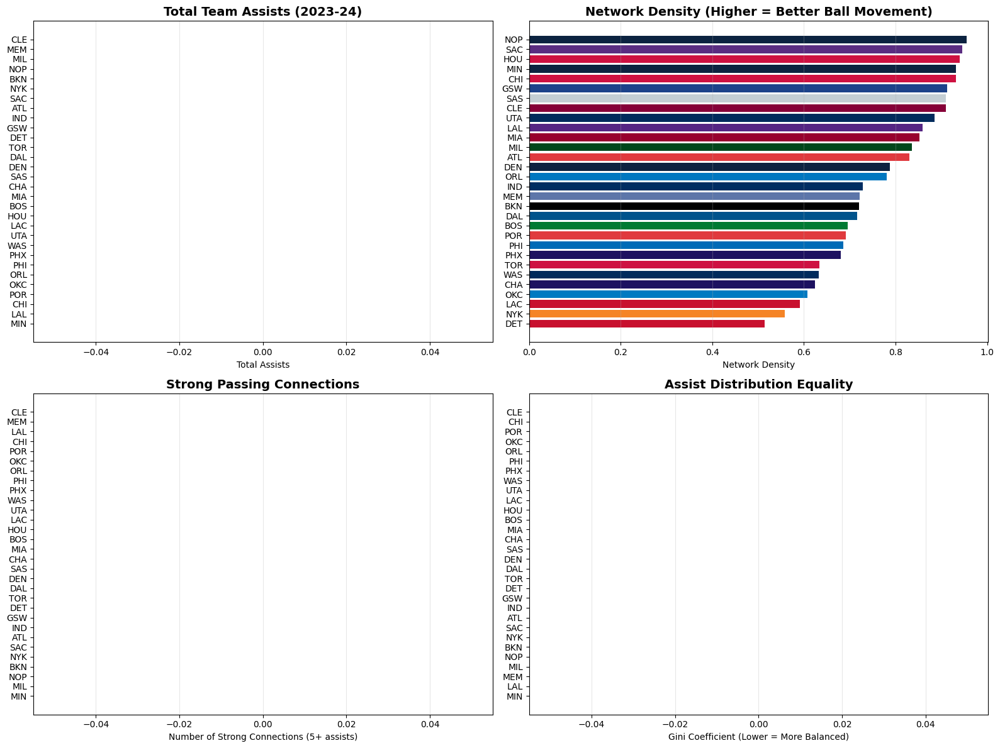

✓ Saved team_network_rankings_2023-24.png


In [25]:
# Visualize team network strength rankings
fig, axes = plt.subplots(2, 2, figsize=(16, 12))

# Color bars by team colors
colors = [NBA_TEAM_COLORS.get(t, '#888888') for t in df_metrics['Team']]

# 1. Total Assists by Team
ax1 = axes[0, 0]
bars = ax1.barh(df_metrics['Team'], df_metrics['Total_Assists'], color=colors)
ax1.set_xlabel('Total Assists')
ax1.set_title('Total Team Assists (2023-24)', fontsize=14, fontweight='bold')
ax1.invert_yaxis()
ax1.grid(axis='x', alpha=0.3)

# 2. Network Density (ball movement)
ax2 = axes[0, 1]
df_sorted_density = df_metrics.sort_values('Network_Density', ascending=False)
colors_density = [NBA_TEAM_COLORS.get(t, '#888888') for t in df_sorted_density['Team']]
ax2.barh(df_sorted_density['Team'], df_sorted_density['Network_Density'], color=colors_density)
ax2.set_xlabel('Network Density')
ax2.set_title('Network Density (Higher = Better Ball Movement)', fontsize=14, fontweight='bold')
ax2.invert_yaxis()
ax2.grid(axis='x', alpha=0.3)

# 3. Strong Connections (5+ assists)
ax3 = axes[1, 0]
df_sorted_strong = df_metrics.sort_values('Strong_Connections', ascending=False)
colors_strong = [NBA_TEAM_COLORS.get(t, '#888888') for t in df_sorted_strong['Team']]
ax3.barh(df_sorted_strong['Team'], df_sorted_strong['Strong_Connections'], color=colors_strong)
ax3.set_xlabel('Number of Strong Connections (5+ assists)')
ax3.set_title('Strong Passing Connections', fontsize=14, fontweight='bold')
ax3.invert_yaxis()
ax3.grid(axis='x', alpha=0.3)

# 4. Assist Distribution (Gini) - Lower = more balanced
ax4 = axes[1, 1]
df_sorted_gini = df_metrics.sort_values('Assist_Gini', ascending=True)  # Lower is better
colors_gini = [NBA_TEAM_COLORS.get(t, '#888888') for t in df_sorted_gini['Team']]
ax4.barh(df_sorted_gini['Team'], df_sorted_gini['Assist_Gini'], color=colors_gini)
ax4.set_xlabel('Gini Coefficient (Lower = More Balanced)')
ax4.set_title('Assist Distribution Equality', fontsize=14, fontweight='bold')
ax4.invert_yaxis()
ax4.grid(axis='x', alpha=0.3)

plt.tight_layout()
plt.savefig('team_network_rankings_2023-24.png', dpi=150, bbox_inches='tight', facecolor='white')
plt.show()

print("✓ Saved team_network_rankings_2023-24.png")


## 11. Single Team Network Visualization

Zoom into a specific team's assist network to see player connections in detail.


In [26]:
def visualize_single_team(G, team_abbr, season, output_file=None):
    """
    Create a detailed visualization of a single team's assist network.
    Shows edge labels with assist counts.
    """
    # Filter to season and team
    G_season = filter_by_season(G, season)
    
    # Get team players
    team_nodes = [n for n in G_season.nodes() if get_team_from_node(n) == team_abbr]
    
    if not team_nodes:
        print(f"No players found for {team_abbr} in {season}")
        return None
    
    # Get team subgraph
    G_team = G_season.subgraph(team_nodes).copy()
    
    print(f"\n{team_abbr} {season} Assist Network")
    print(f"Players: {G_team.number_of_nodes()}")
    print(f"Assist Connections: {G_team.number_of_edges()}")
    
    # Calculate total assists
    total_assists = sum(get_weight(d, 0) for _, _, d in G_team.edges(data=True))
    print(f"Total Team Assists: {total_assists}")
    
    # Create PyVis network
    team_color = NBA_TEAM_COLORS.get(team_abbr, '#888888')
    
    net = Network(height='700px', width='100%', bgcolor='#1a1a2e', 
                  font_color='white', directed=True, notebook=True,
                  cdn_resources='in_line')
    
    # Calculate weighted degrees
    weighted_out = dict(G_team.out_degree(weight='weight'))
    weighted_in = dict(G_team.in_degree(weight='weight'))
    weighted_total = {n: weighted_out.get(n, 0) + weighted_in.get(n, 0) for n in G_team.nodes()}
    max_weight = max(weighted_total.values()) if weighted_total else 1
    
    # Get max edge weight
    edge_weights = [get_weight(d, 1) for _, _, d in G_team.edges(data=True)]
    max_edge_weight = max(edge_weights) if edge_weights else 1
    
    # Use circular layout for single team (cleaner)
    pos = nx.circular_layout(G_team)
    scale = 400
    
    # Add nodes
    for node in G_team.nodes():
        player_name = node.split(',')[0].strip()
        w = weighted_total.get(node, 0)
        
        # Size based on involvement
        size = 20 + 50 * (w / max_weight) if max_weight > 0 else 20
        
        # Tooltip
        tooltip = f"<b>{player_name}</b><br>"
        tooltip += f"Assists Given: {weighted_out.get(node, 0)}<br>"
        tooltip += f"Assists Received: {weighted_in.get(node, 0)}<br>"
        tooltip += f"Total: {w}"
        
        coords = pos.get(node, (0, 0))
        
        net.add_node(node,
                    label=player_name,
                    title=tooltip,
                    color=team_color,
                    size=size,
                    x=coords[0] * scale,
                    y=coords[1] * scale,
                    font={'size': 14, 'color': 'white'})
    
    # Add edges with labels
    for source, target, data in G_team.edges(data=True):
        weight = get_weight(data, 1)
        edge_width = 1 + 6 * (weight / max_edge_weight)
        
        net.add_edge(source, target,
                    width=edge_width,
                    label=str(int(weight)),
                    title=f"{int(weight)} assists",
                    color={'color': team_color, 'opacity': 0.7},
                    arrows={'to': {'enabled': True, 'scaleFactor': 0.4}},
                    font={'size': 12, 'color': 'white', 'strokeWidth': 0, 
                          'background': 'rgba(0,0,0,0.7)'})
    
    net.toggle_physics(False)
    
    net.set_options('''
    {
      "nodes": {
        "borderWidth": 3,
        "borderWidthSelected": 5,
        "font": {"size": 14, "strokeWidth": 4, "strokeColor": "#1a1a2e"}
      },
      "edges": {
        "smooth": {"enabled": true, "type": "curvedCW", "roundness": 0.2},
        "font": {"size": 12, "align": "middle"}
      },
      "interaction": {"hover": true, "tooltipDelay": 50}
    }
    ''')
    
    if output_file is None:
        output_file = f'team_{team_abbr}_{season.replace("-", "_")}.html'
    
    net.save_graph(output_file)
    print(f"✓ Saved {output_file}")
    
    return G_team

# Example: Visualize Boston Celtics (2023-24 Champions runner-up, known for great ball movement)
visualize_single_team(G_assist, 'BOS', '2023-24')

# Visualize Denver Nuggets (2022-23 Champions)
visualize_single_team(G_assist, 'DEN', '2023-24')



BOS 2023-24 Assist Network
Players: 16
Assist Connections: 167
Total Team Assists: 0.0
✓ Saved team_BOS_2023_24.html

DEN 2023-24 Assist Network
Players: 12
Assist Connections: 104
Total Team Assists: 0.0
✓ Saved team_DEN_2023_24.html
